In [1]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
from joblib import Parallel, delayed
import subprocess
import os
import pywt
%matplotlib inline
from matplotlib import animation
from scipy.io import loadmat
from scipy.interpolate import RectBivariateSpline as rbs
import scipy.sparse as sp
import obspy
import sys
sys.path.append("Snippets/")
import data_cleanup
from cartopy.io.img_tiles import Stamen, MapboxStyleTiles
from matplotlib import cm
from matplotlib.colors import ListedColormap, LinearSegmentedColormap

In [2]:
evname="Ridgecrest_71_hh"

In [3]:
%run -i "Snippets/common_functions_and_variables.py"

In [4]:
data_dir = "Data/20190706-Ridgecrest-7.1/"

data = obspy.core.read(data_dir + "*.sac")

data.merge(fill_value=0)

data.detrend()

data.filter('bandpass', freqmin=1/15, freqmax=0.5, zerophase=True)

data.decimate(10, no_filter=True)
 

for (i, tr) in enumerate(data):
    network, station, location, channel = tr.id.split('.')
    tr.stats.latitude = tr.stats.sac['stla']
    tr.stats.longitude = tr.stats.sac['stlo']
    easting, northing = proj.transform_point(tr.stats.longitude, tr.stats.latitude, geo)
    tr.stats.easting = easting/1000
    tr.stats.northing = northing/1000
    distance, az, baz = obspy.geodetics.gps2dist_azimuth(tr.stats.sac['evla'], tr.stats.sac['evlo'],tr.stats.latitude, tr.stats.longitude)
    tr.stats.distance = distance/1000
    tr.stats.az = az
    tr.stats.baz = baz


In [5]:
all_stations = {tr.stats.station for tr in data}

data_reject, j = data_cleanup.correct_data(data, all_stations, "Data/station_conversion_list.csv", "Data/station_actions.csv")

starttime = data[0].stats.starttime
data.trim(starttime=(starttime+25)) # first 25s are pretty boring and make the initial inversion very slow as they are incoherent

latmin = np.min([tr.stats.latitude for tr in data])
latmax = np.max([tr.stats.latitude for tr in data])
lonmin = np.sort([tr.stats.longitude for tr in data])[3] # want to cut out outlier to the west
lonmax = np.max([tr.stats.longitude for tr in data])

for tr in data:
    test1 = (tr.stats.latitude >= latmin)
    test2 = (tr.stats.latitude <= latmax)
    test3 = (tr.stats.longitude >= lonmin)
    test4 = (tr.stats.longitude <= lonmax)
    if test1*test2*test3*test4 == 1:
        pass
    else:
        data_reject += tr
        data.remove(tr) 

In [6]:
from scipy.spatial import ConvexHull
x = np.array([tr.stats.easting for tr in data.select(channel="HNZ")])
y = np.array([tr.stats.northing for tr in data.select(channel="HNZ")])
points = np.array([x,y]).T
hull = ConvexHull(points)
hullpoints = points[hull.vertices]
np.save("Scratch/convex_hull_points.npy", hullpoints)

In [7]:
corners = np.load("Scratch/rectangle_corners.npy")
vec1 = corners[:,1]-corners[:,2]
vec2 = corners[:,3]-corners[:,2]
l1 = np.sqrt(np.sum(np.square(vec1)))
l2 = np.sqrt(np.sum(np.square(vec2)))
t1 = np.linspace(0, l1, 65)
t2 = np.linspace(0, l2, 65)

t1 = (t1[1:]+t1[:-1])/2
t2 = (t2[1:]+t2[:-1])/2

points_corr = points-corners[:,2]
proj_1 = l1*(points_corr@vec1[:,np.newaxis] / np.sum(np.square(vec1))).flatten()
proj_2 = l2*(points_corr@vec2[:,np.newaxis] / np.sum(np.square(vec2))).flatten()

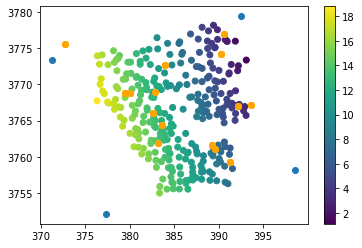

In [8]:
cax = plt.scatter(x,y,c=proj_1)
plt.scatter([tr.stats.easting for tr in data_reject], [tr.stats.northing for tr in data_reject], color='orange')
plt.scatter(corners[0,:], corners[1,:])
plt.colorbar(cax)

In [9]:
back_azimuth = np.rad2deg(np.arctan2(vec2[0], vec2[1])) % 360
print(back_azimuth)
for tr in data:
    tr.stats.back_azimuth = back_azimuth
    
data.rotate("NE->RT")
data.detrend()
data.taper(0.05)

164.082949863


843 Trace(s) in Stream:

CJ.LAS001..HNT | 2019-07-06T03:20:18.000000Z - 2019-07-06T03:23:13.000000Z | 5.0 Hz, 876 samples
...
(841 other traces)
...
CJ.LAS304..HNZ | 2019-07-06T03:20:18.000000Z - 2019-07-06T03:23:13.000000Z | 5.0 Hz, 876 samples

[Use "print(Stream.__str__(extended=True))" to print all Traces]

In [10]:
ndata = np.std([tr.data for tr in data])
for tr in data:
    tr.data = tr.data / ndata

In [11]:
cscale = 2.0

crv = loadmat("../Curvelet_Basis_Construction/G_64_64.mat")
G_mat = crv["G"]
crvscales = crv["s"][0]
G_mat = np.reshape(G_mat.T, (G_mat.shape[1], 64,64))
cvtscaler = (2.0**(cscale*crvscales))
G1s_rows = []
G1s_cols = []
G1s_vals = []
G1i_rows = []
G1i_cols = []
G1i_vals = []
G2s_rows = []
G2s_cols = []
G2s_vals = []
G2i_rows = []
G2i_cols = []
G2i_vals = []

Ge = []
Gl = []

for j in range(G_mat.shape[0]):
    frame = rbs(t1,t2,G_mat[j])

    G1s_col = frame.ev(proj_1,proj_2, dy=1)
    G1s_selector = np.nonzero(np.log10(np.abs(G1s_col))-np.max(np.log10(np.abs(G1s_col))) > -15)[0] # if <0.1% max, get rid of it
    G1s_rows += [i for i in G1s_selector]
    G1s_cols += [j for i in G1s_selector]
    G1s_vals += [G1s_col[i]/cvtscaler[j] for i in G1s_selector]

    G2s_col = -frame.ev(proj_1,proj_2,dx=1)
    G2s_selector = np.nonzero(np.log10(np.abs(G2s_col))-np.max(np.log10(np.abs(G2s_col))) > -15)[0] # if <0.1% max, get rid of it
    G2s_rows += [i for i in G2s_selector]
    G2s_cols += [j for i in G2s_selector]
    G2s_vals += [G2s_col[i]/cvtscaler[j] for i in G2s_selector]

    G1i_col = frame.ev(proj_1,proj_2,dx=1)
    G1i_selector = np.nonzero(np.log10(np.abs(G1i_col))-np.max(np.log10(np.abs(G1i_col))) > -15)[0] # if <0.1% max, get rid of it
    G1i_rows += [i for i in G1i_selector]
    G1i_cols += [j for i in G1i_selector]
    G1i_vals += [G1i_col[i]/cvtscaler[j] for i in G1i_selector]

    G2i_col = frame.ev(proj_1,proj_2, dy=1)
    G2i_selector = np.nonzero(np.log10(np.abs(G2i_col))-np.max(np.log10(np.abs(G2i_col))) > -15)[0] # if <0.1% max, get rid of it
    G2i_rows += [i for i in G2i_selector]
    G2i_cols += [j for i in G2i_selector]
    G2i_vals += [G2i_col[i]/cvtscaler[j] for i in G2i_selector]

    Ge += [frame.ev(proj_1, proj_2)/cvtscaler[j]]
    Gl += [frame.ev(proj_1, proj_2, dx=2)/cvtscaler[j] + frame.ev(proj_1, proj_2, dy=2)/cvtscaler[j]]


G1s = sp.coo_matrix((G1s_vals, (G1s_rows, G1s_cols)), shape=(len(x), G_mat.shape[0]))
G2s = sp.coo_matrix((G2s_vals, (G2s_rows, G2s_cols)), shape=(len(x), G_mat.shape[0]))
G1i = sp.coo_matrix((G1i_vals, (G1i_rows, G1i_cols)), shape=(len(x), G_mat.shape[0]))
G2i = sp.coo_matrix((G2i_vals, (G2i_rows, G2i_cols)), shape=(len(x), G_mat.shape[0]))

G = sp.hstack([sp.vstack([G1s,G2s]), sp.vstack([G1i,G2i])])
Gn = np.sqrt(G.power(2).sum()/G.nnz - G.mean()**2)
G = G / Gn
Gevp = G_mat / cvtscaler[:,np.newaxis,np.newaxis] / Gn

Ge = np.array(Ge)/Gn
Gl = np.array(Gl)/Gn

sp.save_npz("Scratch/Gcsc.npz", G.tocsc())
np.save("Scratch/G.npy", G.todense())
np.save("Scratch/G_evp.npy", Gevp)
np.save("Scratch/Ge", Ge)
np.save("Scratch/Gl", Gl)

In [12]:
wvt = 'db12'

wvt_data1 = np.array([np.hstack(pywt.wavedec(tr.data, wvt)) for tr in data.select(channel="HNT")])
wvt_data2 = np.array([np.hstack(pywt.wavedec(tr.data, wvt)) for tr in data.select(channel="HNR")])

d = np.vstack([wvt_data1, wvt_data2])
nchannels, ncoefs = d.shape

np.save("Scratch/d.npy", d)

In [13]:
run_reconstruction = False

if run_reconstruction:
    julia_path = "/Applications/Julia-1.5.app/Contents/Resources/julia/bin/julia"
    subprocess.run(f"{julia_path} Lasso_threads.jl", shell=True, env={"JULIA_NUM_THREADS" : "12"})

In [14]:
res = sp.load_npz("Scratch/results.npz")

In [15]:
hres = int(res.shape[0]/2)
res_s = res[:hres,:]
res_i = res[hres:,:]

In [16]:
wvt_tmp = pywt.wavedec(data[0].data, wvt)
wvt_lens = [len(wc) for wc in wvt_tmp]

In [17]:
wvt_reconstructions_1I = np.array((G1i@res_i).todense())/Gn
d_reconstructions_1I = np.real(np.array([reconstruction(w, wvt_lens, wvt) for w in wvt_reconstructions_1I]))

wvt_reconstructions_1S = np.array((G1s@res_s).todense())/Gn
d_reconstructions_1S = np.real(np.array([reconstruction(w, wvt_lens, wvt) for w in wvt_reconstructions_1S]))

wvt_reconstructions_2I = np.array((G2i@res_i).todense())/Gn
d_reconstructions_2I = np.real(np.array([reconstruction(w, wvt_lens, wvt) for w in wvt_reconstructions_2I]))

wvt_reconstructions_2S = np.array((G2s@res_s).todense())/Gn
d_reconstructions_2S = np.real(np.array([reconstruction(w, wvt_lens, wvt) for w in wvt_reconstructions_2S]))

In [18]:
data_reconstructed_1i = data.select(channel="HNT").copy()
for i, tr in enumerate(data_reconstructed_1i):
    tr.data = d_reconstructions_1I[i,:]
    
data_reconstructed_1s = data.select(channel="HNT").copy()
for i, tr in enumerate(data_reconstructed_1s):
    tr.data = d_reconstructions_1S[i,:]
    
data_reconstructed_2i = data.select(channel="HNR").copy()
for i, tr in enumerate(data_reconstructed_2i):
    tr.data = d_reconstructions_2I[i,:]
    
data_reconstructed_2s = data.select(channel="HNR").copy()
for i, tr in enumerate(data_reconstructed_2s):
    tr.data = d_reconstructions_2S[i,:]
    
data_reconstructed_1 = data.select(channel="HNT").copy()
for i, tr in enumerate(data_reconstructed_1):
    tr.data = d_reconstructions_1I[i,:]+d_reconstructions_1S[i,:]
    
data_reconstructed_2 = data.select(channel="HNR").copy()
for i, tr in enumerate(data_reconstructed_2):
    tr.data = d_reconstructions_2I[i,:]+d_reconstructions_2S[i,:]
    

Snippets/common_functions_and_variables.py:116: MatplotlibDeprecationWarning: 
The set_smart_bounds function was deprecated in Matplotlib 3.2 and will be removed two minor releases later.
  spine.set_smart_bounds(True)
Snippets/common_functions_and_variables.py:116: MatplotlibDeprecationWarning: 
The set_smart_bounds function was deprecated in Matplotlib 3.2 and will be removed two minor releases later.
  spine.set_smart_bounds(True)
Snippets/common_functions_and_variables.py:116: MatplotlibDeprecationWarning: 
The set_smart_bounds function was deprecated in Matplotlib 3.2 and will be removed two minor releases later.
  spine.set_smart_bounds(True)
Snippets/common_functions_and_variables.py:116: MatplotlibDeprecationWarning: 
The set_smart_bounds function was deprecated in Matplotlib 3.2 and will be removed two minor releases later.
  spine.set_smart_bounds(True)
Snippets/common_functions_and_variables.py:116: MatplotlibDeprecationWarning: 
The set_smart_bounds function was deprecated 

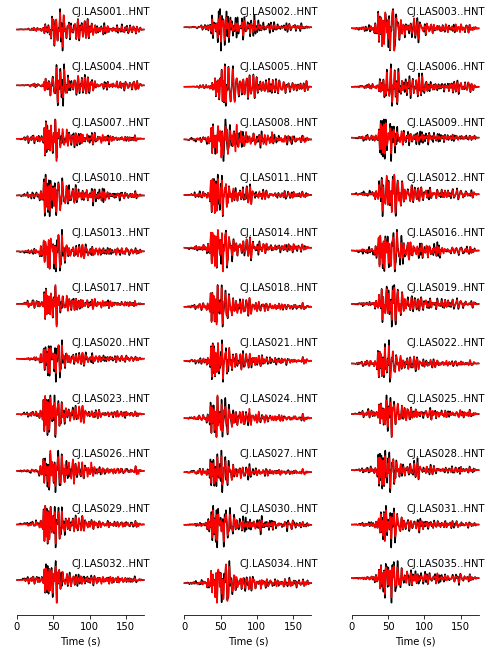

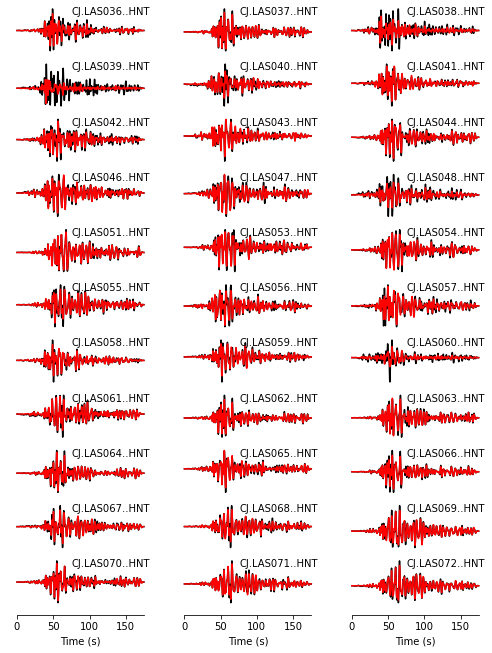

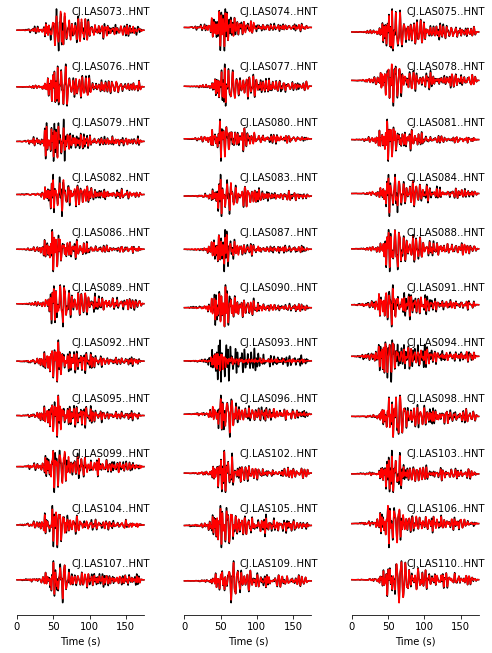

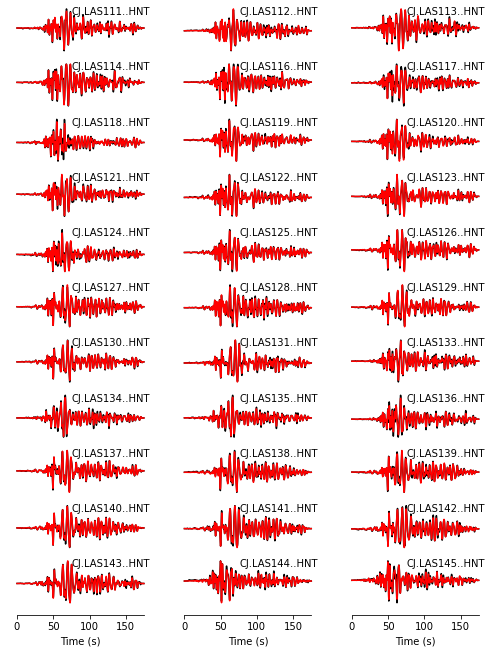

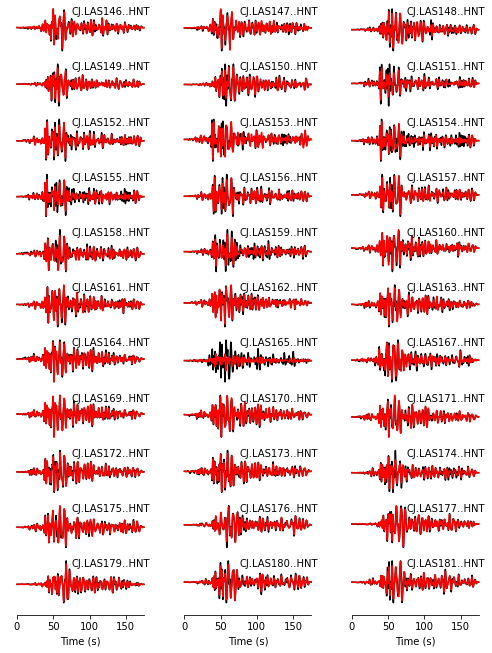

...

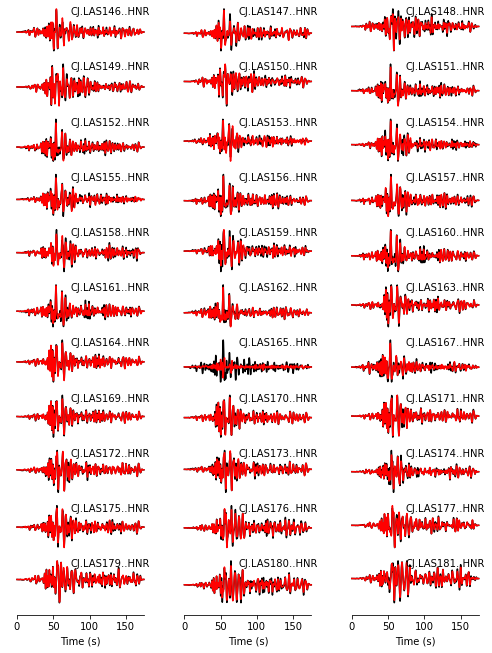

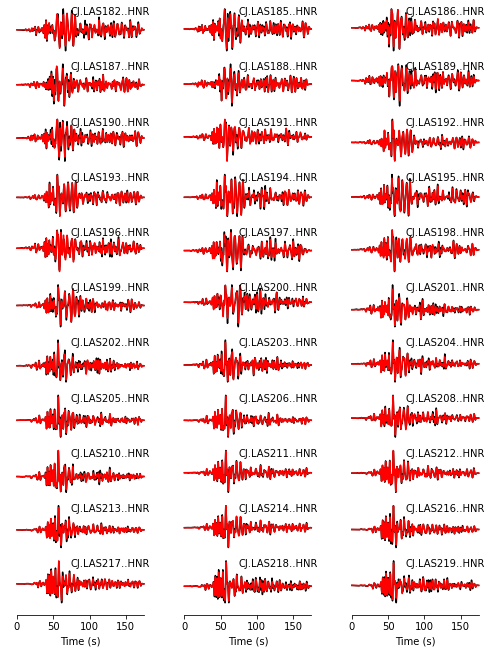

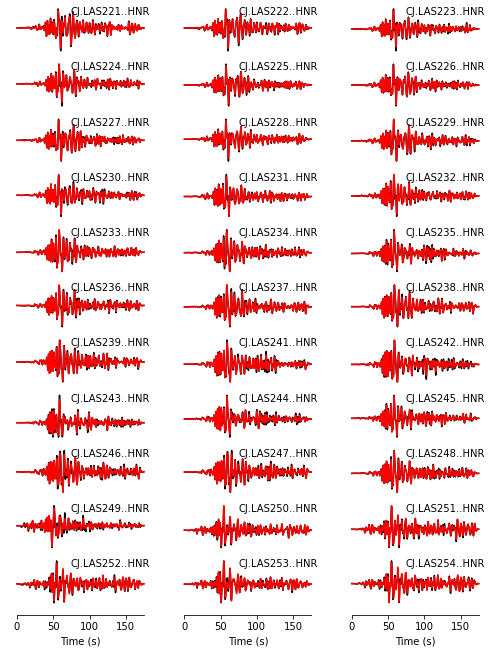

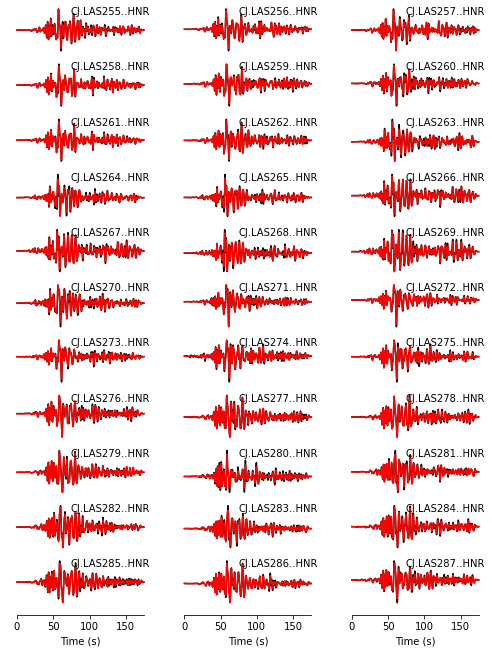

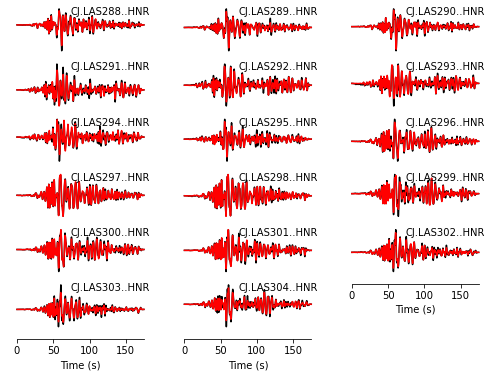

In [19]:
ntraces = len(data.select(channel="HNT"))
nsheets = ntraces //33 + 1

for i in range(nsheets):
    plot_sheet(data.select(channel="HNT")[i*33:(i+1)*33], data_reconstructed_1[i*33:(i+1)*33], savename=f"Scratch/sheet_e{i}.pdf")
    
ntraces = len(data.select(channel="HNR"))
nsheets = ntraces //33 + 1

for i in range(nsheets):
    plot_sheet(data.select(channel="HNR")[i*33:(i+1)*33], data_reconstructed_2[i*33:(i+1)*33], savename=f"Scratch/sheet_n{i}.pdf")

In [20]:
coloro = "#FF6C0C"
colorb = "#00A1DF"
colorgr = "#C8C8C8"
colorp = "#F54D80"

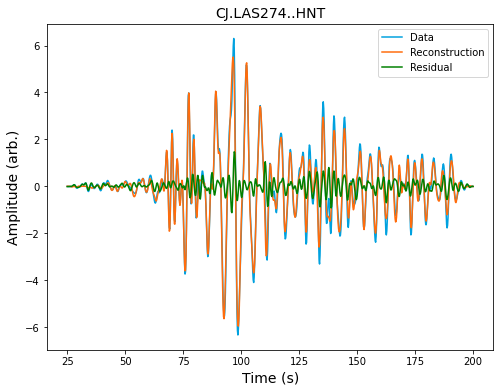

In [21]:
i = 250
plt.figure(figsize=(8,6))
plt.plot(25+data.select(channel="HNT")[i].times(), data.select(channel="HNT")[i].data, c=colorb, label="Data")
plt.plot(25+data.select(channel="HNT")[i].times(),data_reconstructed_1[i].data, c = coloro, label="Reconstruction")
plt.plot(25+data.select(channel="HNT")[i].times(), data.select(channel="HNT")[i].data-data_reconstructed_1[i].data, c = 'g', label="Residual")
plt.title(data.select(channel="HNT")[i].id, fontsize=14)
plt.xlabel("Time (s)", fontsize=14)
plt.ylabel("Amplitude (arb.)", fontsize=14)
plt.legend(loc='best')
plt.savefig("csn_reconstruct.pdf")


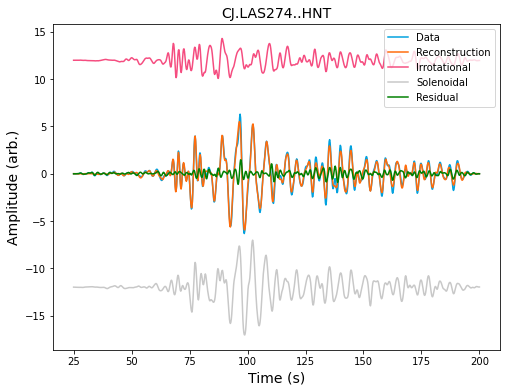

In [22]:
i = 250
plt.figure(figsize=(8,6))
plt.plot(25+data.select(channel="HNT")[i].times(), data.select(channel="HNT")[i].data, c=colorb, label="Data")
plt.plot(25+data.select(channel="HNT")[i].times(),data_reconstructed_1[i].data, c = coloro, label="Reconstruction")
plt.plot(25+data.select(channel="HNT")[i].times(),data_reconstructed_1i[i].data+12,c = colorp, label="Irrotational")
plt.plot(25+data.select(channel="HNT")[i].times(),data_reconstructed_1s[i].data-12,c = colorgr, label="Solenoidal")
plt.plot(25+data.select(channel="HNT")[i].times(), data.select(channel="HNT")[i].data-data_reconstructed_1[i].data, c = 'g', label="Residual")
plt.title(data.select(channel="HNT")[i].id, fontsize=14)
plt.xlabel("Time (s)", fontsize=14)
plt.ylabel("Amplitude (arb.)", fontsize=14)
plt.legend(loc='best')
plt.savefig("csn_reconstruct.pdf")


In [23]:
data_reconstructed = data_reconstructed_1.copy() + data_reconstructed_2.copy()
data_reconstructed.rotate("RT->NE")

562 Trace(s) in Stream:

CJ.LAS001..HNE | 2019-07-06T03:20:18.000000Z - 2019-07-06T03:23:13.000000Z | 5.0 Hz, 876 samples
...
(560 other traces)
...
CJ.LAS304..HNN | 2019-07-06T03:20:18.000000Z - 2019-07-06T03:23:13.000000Z | 5.0 Hz, 876 samples

[Use "print(Stream.__str__(extended=True))" to print all Traces]

In [24]:
data_reconstructed_i = data_reconstructed_1i.copy()+data_reconstructed_2i.copy()
data_reconstructed_i.rotate("RT->NE")

562 Trace(s) in Stream:

CJ.LAS001..HNE | 2019-07-06T03:20:18.000000Z - 2019-07-06T03:23:13.000000Z | 5.0 Hz, 876 samples
...
(560 other traces)
...
CJ.LAS304..HNN | 2019-07-06T03:20:18.000000Z - 2019-07-06T03:23:13.000000Z | 5.0 Hz, 876 samples

[Use "print(Stream.__str__(extended=True))" to print all Traces]

In [25]:
data_reconstructed_s = data_reconstructed_1s.copy()+data_reconstructed_2s.copy()
data_reconstructed_s.rotate("RT->NE")

562 Trace(s) in Stream:

CJ.LAS001..HNE | 2019-07-06T03:20:18.000000Z - 2019-07-06T03:23:13.000000Z | 5.0 Hz, 876 samples
...
(560 other traces)
...
CJ.LAS304..HNN | 2019-07-06T03:20:18.000000Z - 2019-07-06T03:23:13.000000Z | 5.0 Hz, 876 samples

[Use "print(Stream.__str__(extended=True))" to print all Traces]

In [26]:
data.rotate("RT->NE")

843 Trace(s) in Stream:

CJ.LAS001..HNE | 2019-07-06T03:20:18.000000Z - 2019-07-06T03:23:13.000000Z | 5.0 Hz, 876 samples
...
(841 other traces)
...
CJ.LAS304..HNZ | 2019-07-06T03:20:18.000000Z - 2019-07-06T03:23:13.000000Z | 5.0 Hz, 876 samples

[Use "print(Stream.__str__(extended=True))" to print all Traces]

In [27]:
coloro = "#FF6C0C"
colorb = "#00A1DF"
colorgr = "#C8C8C8"
colorp = "#F54D80"

In [29]:
stamen = Stamen(style='terrain')
# to reproduce the figures in the paper, you have to supply a mapbox api token and uncomment the mapbox lines below
# while commenting out the stamen lines
# mapbox = MapboxStyleTiles(api_token, "jbmuir", "ck9uhcy3506p71inwrjo50vq0")

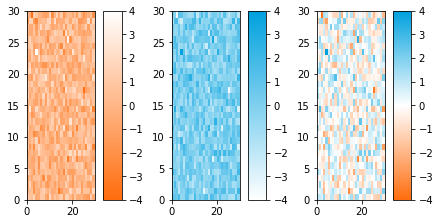

In [30]:
N = 256
vals1 = np.ones((N, 4))
vals1[:, 0] = np.linspace(255/255, 1, N)
vals1[:, 1] = np.linspace(108/255, 1, N)
vals1[:, 2] = np.linspace(12/255, 1, N)
newcmp1 = ListedColormap(vals1)

N = 256
vals2 = np.ones((N, 4))
vals2[:, 0] = np.linspace(1, 0, N)
vals2[:, 1] = np.linspace(1, 161/255, N)
vals2[:, 2] = np.linspace(1, 223/256, N)
newcmp2 = ListedColormap(vals2)

newcmp3 = ListedColormap(np.vstack([vals1,vals2]))

def plot_examples(cms):
    """
    helper function to plot two colormaps
    """
    np.random.seed(19680801)
    data = np.random.randn(30, 30)

    fig, axs = plt.subplots(1, 3, figsize=(6, 3), constrained_layout=True)
    for [ax, cmap] in zip(axs, cms):
        psm = ax.pcolormesh(data, cmap=cmap, rasterized=True, vmin=-4, vmax=4)
        fig.colorbar(psm, ax=ax)
    plt.show()

plot_examples([newcmp1, newcmp2, newcmp3])

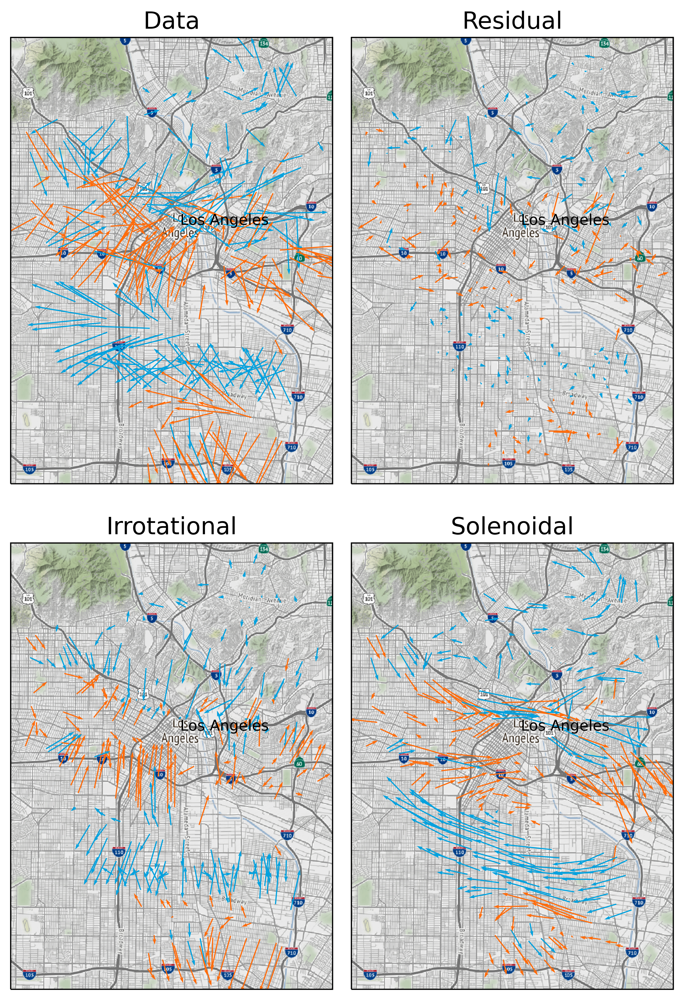

In [32]:
fig = plt.figure(figsize=(8,12), dpi=500)

i = 250

#matplotlib bug means we need to add a mini jitter to color function to get it to plot, hence the random normals

data_z = data.select(channel="HNZ")

ax1 = plt.subplot2grid((4,6), (0, 0), rowspan=2, colspan=3, projection=proj)
q1 = ax1.quiver(np.array([tr.stats.longitude for tr in data.select(channel="HNE")]),
                  np.array([tr.stats.latitude for tr in data.select(channel="HNE")]), 
                  np.array([tr.data[i] for tr in data.select(channel="HNE")]), 
                  np.array([tr.data[i] for tr in data.select(channel="HNN")]),
                  np.sign(np.array([tr.data[i]+np.random.normal(0,1e-15) for tr in data.select(channel="HNZ")])),
                  transform=ccrs.PlateCarree(), units='xy', scale=1e-3, cmap=newcmp3)

ax1.set_title("Data", fontsize=16)

ax2 = plt.subplot2grid((4,6), (0, 3), rowspan=2, colspan=3, projection=proj)
q2 = ax2.quiver(np.array([tr.stats.longitude for tr in data.select(channel="HNE")]),
                  np.array([tr.stats.latitude for tr in data.select(channel="HNE")]), 
                  np.array([tr1.data[i]-tr2.data[i] for tr1, tr2 in zip(data.select(channel="HNE"), data_reconstructed.select(channel="HNE"))]), 
                  np.array([tr1.data[i]-tr2.data[i] for tr1, tr2 in zip(data.select(channel="HNN"), data_reconstructed.select(channel="HNN"))]),
                 np.sign(np.array([tr.data[i] +np.random.normal(0,1e-15) for tr in data.select(channel="HNZ")])),
                  transform=ccrs.PlateCarree(), units='xy', scale=1e-3, cmap=newcmp3)

ax2.set_title("Residual", fontsize=16)

ax3 = plt.subplot2grid((4,6), (2, 0), rowspan=2, colspan=3, projection=proj)
q3 = ax3.quiver(np.array([tr.stats.longitude for tr in data.select(channel="HNE")]),
                  np.array([tr.stats.latitude for tr in data.select(channel="HNE")]), 
                  np.array([tr.data[i] for tr in data_reconstructed_i.select(channel="HNE")]), 
                  np.array([tr.data[i] for tr in data_reconstructed_i.select(channel="HNN")]),
                  np.sign(np.array([tr.data[i]+np.random.normal(0,1e-15)  for tr in data.select(channel="HNZ")])),
                  transform=ccrs.PlateCarree(), units='xy', scale=1e-3, cmap=newcmp3)

ax3.set_title("Irrotational", fontsize=16)

ax4 = plt.subplot2grid((4,6), (2, 3), rowspan=2, colspan=3, projection=proj)
q4 = ax4.quiver(np.array([tr.stats.longitude for tr in data.select(channel="HNE")]),
                  np.array([tr.stats.latitude for tr in data.select(channel="HNE")]), 
                  np.array([tr.data[i] for tr in data_reconstructed_s.select(channel="HNE")]), 
                  np.array([tr.data[i] for tr in data_reconstructed_s.select(channel="HNN")]),
                  np.sign(np.array([tr.data[i]+np.random.normal(0,1e-15) for tr in data.select(channel="HNZ")])),                                                    
                  transform=ccrs.PlateCarree(), units='xy', scale=1e-3, cmap=newcmp3)

ax4.set_title("Solenoidal", fontsize=16)


for ax in fig.axes: 
      ax.text(-118.2437, 34.0522, "Los Angeles", transform = ccrs.PlateCarree())
      ax.add_image(stamen, 12)
#       ax.add_image(mapbox, 12)

    
fig.savefig(f"ExampleHH_{i/data[0].stats.sampling_rate}.pdf")

In [33]:
i = 250
chanlat = data.select(channel="HNE")[i].stats.latitude
chanlon = data.select(channel="HNE")[i].stats.longitude


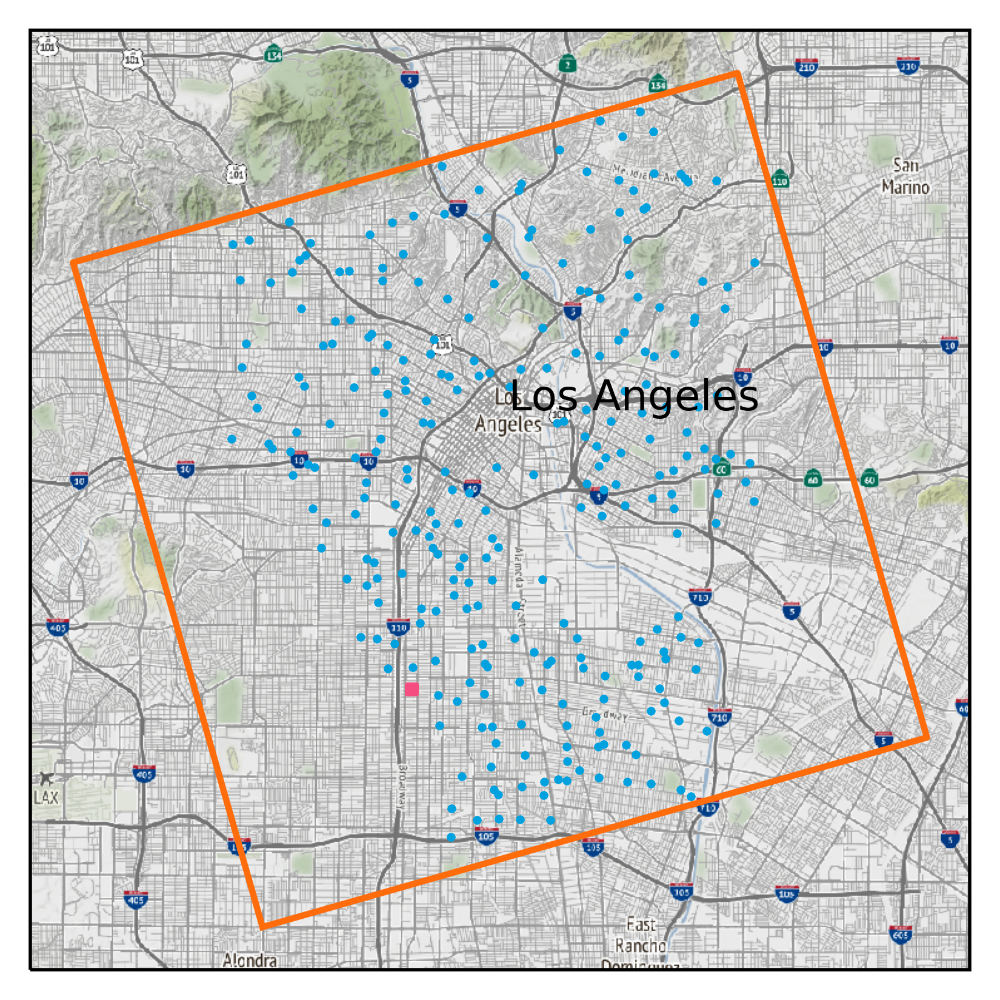

In [34]:
coloro = "#FF6C0C"
colorb = "#00A1DF"
colorgr = "#C8C8C8"
colorp = "#F54D80"

fig = plt.figure(figsize=(4,6), dpi=500)
ax = fig.add_subplot(111, projection=proj)
ax.scatter([tr.stats.easting*1000 for tr in data], [tr.stats.northing*1000 for tr in data], color=colorb, s=1)
ax.plot(1000*np.hstack([corners[0,:], corners[0,0]]), 1000*np.hstack([corners[1,:], corners[1,0]]) , color=coloro)
ax.text(-118.2437, 34.0522, "Los Angeles", transform = ccrs.PlateCarree())
ax.scatter(chanlon, chanlat, color=colorp, s=5, marker='s', transform=ccrs.PlateCarree())
ax.add_image(stamen, 12)
# ax.add_image(mapbox, 12)
fig.savefig("csn_deployment.pdf")

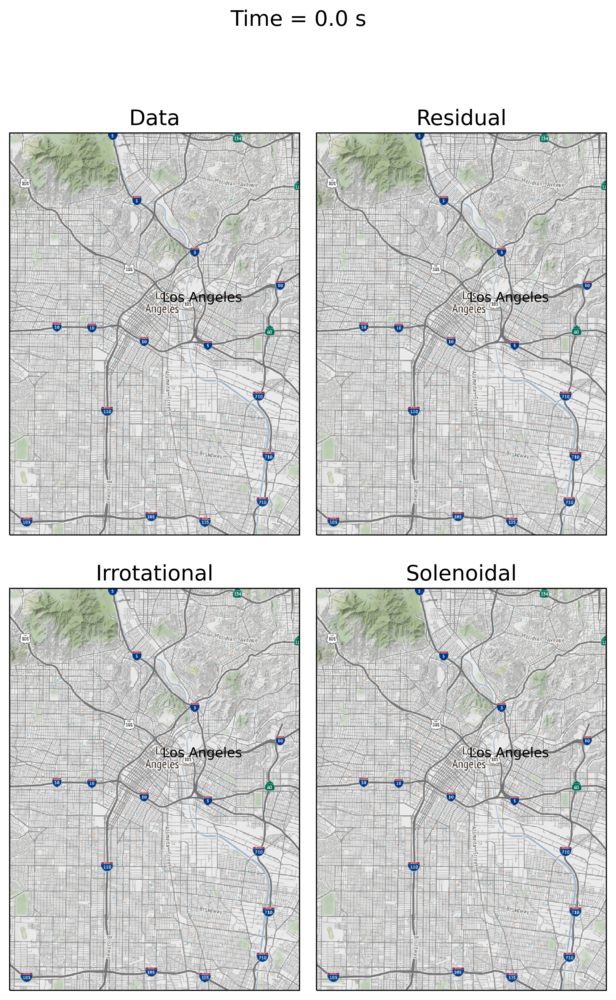

In [35]:
fig = plt.figure(figsize=(8,12), dpi=500)

i = 0

#matplotlib bug means we need to add a mini jitter to color function to get it to plot

fig.suptitle("Time = 0 s", fontsize=16)
data_z = data.select(channel="HNZ")

ax1 = plt.subplot2grid((4,6), (0, 0), rowspan=2, colspan=3, projection=proj)
q1 = ax1.quiver(np.array([tr.stats.longitude for tr in data.select(channel="HNE")]),
                  np.array([tr.stats.latitude for tr in data.select(channel="HNE")]), 
                  np.array([tr.data[i] for tr in data.select(channel="HNE")]), 
                  np.array([tr.data[i] for tr in data.select(channel="HNN")]),
                  np.sign(np.array([tr.data[i]+np.random.normal(0,1e-15) for tr in data.select(channel="HNZ")])),
                  transform=ccrs.PlateCarree(), units='xy', scale=1e-3, cmap=newcmp3)

ax1.set_title("Data", fontsize=16)

ax2 = plt.subplot2grid((4,6), (0, 3), rowspan=2, colspan=3, projection=proj)
q2 = ax2.quiver(np.array([tr.stats.longitude for tr in data.select(channel="HNE")]),
                  np.array([tr.stats.latitude for tr in data.select(channel="HNE")]), 
                  np.array([tr1.data[i]-tr2.data[i] for tr1, tr2 in zip(data.select(channel="HNE"), data_reconstructed.select(channel="HNE"))]), 
                  np.array([tr1.data[i]-tr2.data[i] for tr1, tr2 in zip(data.select(channel="HNN"), data_reconstructed.select(channel="HNN"))]),
                 np.sign(np.array([tr.data[i] +np.random.normal(0,1e-15) for tr in data.select(channel="HNZ")])),
                  transform=ccrs.PlateCarree(), units='xy', scale=1e-3, cmap=newcmp3)

ax2.set_title("Residual", fontsize=16)

ax3 = plt.subplot2grid((4,6), (2, 0), rowspan=2, colspan=3, projection=proj)
q3 = ax3.quiver(np.array([tr.stats.longitude for tr in data.select(channel="HNE")]),
                  np.array([tr.stats.latitude for tr in data.select(channel="HNE")]), 
                  np.array([tr.data[i] for tr in data_reconstructed_i.select(channel="HNE")]), 
                  np.array([tr.data[i] for tr in data_reconstructed_i.select(channel="HNN")]),
                  np.sign(np.array([tr.data[i]+np.random.normal(0,1e-15)  for tr in data.select(channel="HNZ")])),
                  transform=ccrs.PlateCarree(), units='xy', scale=1e-3, cmap=newcmp3)

ax3.set_title("Irrotational", fontsize=16)

ax4 = plt.subplot2grid((4,6), (2, 3), rowspan=2, colspan=3, projection=proj)
q4 = ax4.quiver(np.array([tr.stats.longitude for tr in data.select(channel="HNE")]),
                  np.array([tr.stats.latitude for tr in data.select(channel="HNE")]), 
                  np.array([tr.data[i] for tr in data_reconstructed_s.select(channel="HNE")]), 
                  np.array([tr.data[i] for tr in data_reconstructed_s.select(channel="HNN")]),
                  np.sign(np.array([tr.data[i]+np.random.normal(0,1e-15) for tr in data.select(channel="HNZ")])),                                                    
                  transform=ccrs.PlateCarree(), units='xy', scale=1e-3, cmap=newcmp3)

ax4.set_title("Solenoidal", fontsize=16)

for ax in fig.axes: 
      ax.text(-118.2437, 34.0522, "Los Angeles", transform = ccrs.PlateCarree())
#       ax.add_image(mapbox, 12)
      ax.add_image(stamen, 12)

    

def update_quivers(i):
    fig.suptitle(f"Time = {i/data[0].stats.sampling_rate} s", fontsize=16)
    q1.set_UVC(np.array([tr.data[i] for tr in data.select(channel="HNE")]), 
               np.array([tr.data[i] for tr in data.select(channel="HNN")]),
               np.sign(np.array([tr.data[i]+np.random.normal(0,1e-15) for tr in data_z])))
            

    q2.set_UVC(np.array([tr1.data[i]-tr2.data[i] for tr1, tr2 in zip(data.select(channel="HNE"), data_reconstructed.select(channel="HNE"))]), 
               np.array([tr1.data[i]-tr2.data[i] for tr1, tr2 in zip(data.select(channel="HNN"), data_reconstructed.select(channel="HNN"))]),
               np.sign(np.array([tr.data[i]+np.random.normal(0,1e-15) for tr in data_z])))

    q3.set_UVC(np.array([tr.data[i] for tr in data_reconstructed_i.select(channel="HNE")]), 
               np.array([tr.data[i] for tr in data_reconstructed_i.select(channel="HNN")]),
               np.sign(np.array([tr.data[i]+np.random.normal(0,1e-15) for tr in data_z])))

    q4.set_UVC(np.array([tr.data[i] for tr in data_reconstructed_s.select(channel="HNE")]),
               np.array([tr.data[i] for tr in data_reconstructed_s.select(channel="HNN")]),
               np.sign(np.array([tr.data[i]+np.random.normal(0,1e-15) for tr in data_z])))

    
anim = animation.FuncAnimation(fig, update_quivers, frames=range(0,len(data[0].data)),
                               interval=100, blit=False)

# Set up formatting for the movie files
Writer = animation.writers['ffmpeg']
writer = Writer(fps=10, metadata=dict(artist='Me'), bitrate=1800)

anim.save('hhmovie.mp4', writer=writer)